# SDAV: Crime trends

### Social Data Analysis and Visualization - Human-Centered Artificial Intelligence - DTU - Josep Marin-Llao - 2021

## Import DataSet : [Police Department Incident Reports: Historical 2003 to May 2018](https://data.sfgov.org/Public-Safety/Police-Department-Incident-Reports-Historical-2003/tmnf-yvry)

In [1]:
import pandas as pd 

pd.set_option('display.max_columns', None)


crime_data = pd.read_csv("Police_Department_Incident_Reports__Historical_2003_to_May_2018.csv.part") 
crime_data.head()


,PdId,IncidntNum,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,Address,X,Y,location,SF Find Neighborhoods 2 2,Current Police Districts 2 2,Current Supervisor Districts 2 2,Analysis Neighborhoods 2 2,DELETE - Fire Prevention Districts 2 2,DELETE - Police Districts 2 2,DELETE - Supervisor Districts 2 2,DELETE - Zip Codes 2 2,DELETE - Neighborhoods 2 2,DELETE - 2017 Fix It Zones 2 2,Civic Center Harm Reduction Project Boundary 2 2,Fix It Zones as of 2017-11-06 2 2,DELETE - HSOC Zones 2 2,Fix It Zones as of 2018-02-07 2 2,"CBD, BID and GBD Boundaries as of 2017 2 2","Areas of Vulnerability, 2016 2 2",Central Market/Tenderloin Boundary 2 2,Central Market/Tenderloin Boundary Polygon - Updated 2 2,HSOC Zones as of 2018-06-05 2 2,OWED Public Spaces 2 2,Neighborhoods 2
0,4018830907041,40188309,7041,VEHICLE THEFT,"VEHICLE, RECOVERED, AUTO",Sunday,02/15/2004,02:00,SOUTHERN,NONE,BRANNAN ST / 1ST ST,-120.500000,90.000000,POINT (-120.50000000000001 90),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,13605159706372,136051597,6372,LARCENY/THEFT,PETTY THEFT OF PROPERTY,Thursday,03/14/2013,09:21,SOUTHERN,NONE,1300 Block of STEVENSON ST,-122.421595,37.770767,POINT (-122.421594519119 37.7707674171464),32.0,1.0,10.0,20.0,8.0,2.0,9.0,28853.0,19.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,32.0
2,13618826906244,136188269,6244,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Tuesday,10/08/2013,19:30,MISSION,NONE,VALENCIA ST / DUBOCE AV,-122.422367,37.769868,POINT (-122.422367409563 37.7698682392455),NaN,3.0,5.0,20.0,8.0,4.0,5.0,28853.0,19.0,NaN,NaN,NaN,3.0,NaN,NaN,2.0,NaN,NaN,3.0,NaN,NaN
3,4098938926105,40989389,26105,OTHER OFFENSES,FALSE REPORT OF BOMB,Sunday,08/29/2004,22:47,PARK,NONE,300 Block of WOODSIDE AV,-122.452717,37.745745,POINT (-122.452716700987 37.7457451434135),49.0,7.0,8.0,38.0,1.0,5.0,4.0,59.0,38.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,49.0
4,5085058207021,50850582,7021,VEHICLE THEFT,STOLEN AUTOMOBILE,Friday,07/29/2005,21:00,INGLESIDE,NONE,0 Block of RAE AV,-122.448127,37.712164,POINT (-122.448127287476 37.7121636146229),66.0,9.0,1.0,28.0,9.0,7.0,6.0,28861.0,25.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,66.0


## Preprocessing and Desriptive Statistics : 

### 0.1. Total number of crimes/entries in DataSet : 

In [2]:
len(crime_data)

577208

### 0.2. Crime categories : 

In [3]:
crime_categories_set = set(crime_data["Category"])
crime_categories_set

{'ARSON',
 'ASSAULT',
 'BAD CHECKS',
 'BRIBERY',
 'BURGLARY',
 'DISORDERLY CONDUCT',
 'DRIVING UNDER THE INFLUENCE',
 'DRUG/NARCOTIC',
 'DRUNKENNESS',
 'EMBEZZLEMENT',
 'EXTORTION',
 'FAMILY OFFENSES',
 'FORGERY/COUNTERFEITING',
 'FRAUD',
 'GAMBLING',
 'KIDNAPPING',
 'LARCENY/THEFT',
 'LIQUOR LAWS',
 'LOITERING',
 'MISSING PERSON',
 'NON-CRIMINAL',
 'OTHER OFFENSES',
 'PORNOGRAPHY/OBSCENE MAT',
 'PROSTITUTION',
 'RECOVERED VEHICLE',
 'ROBBERY',
 'SECONDARY CODES',
 'SEX OFFENSES, FORCIBLE',
 'SEX OFFENSES, NON FORCIBLE',
 'STOLEN PROPERTY',
 'SUICIDE',
 'SUSPICIOUS OCC',
 'TREA',
 'TRESPASS',
 'VANDALISM',
 'VEHICLE THEFT',
 'WARRANTS',
 'WEAPON LAWS'}

There are the following amount of categories:

In [4]:
len(crime_categories_set)

38

## 0.3. Amout of crimes in each category 

It is considered each row/entry as a crime/incident, which would be identified by the "IncidntNum" or the "IncidentCode".

### 0.3.1. Built-in  `pandas.df` function `.count` 

In [5]:
crime_data_count = crime_data.set_index(["Category", "IncidntNum"]).count(level="Category")
crime_data_count.drop(crime_data_count.columns.difference(['Incident Code']), 1, inplace=True)
crime_data_count

,Incident Code
Category,
ARSON,1008
ASSAULT,51339
BAD CHECKS,301
BRIBERY,198
BURGLARY,25007
DISORDERLY CONDUCT,3014
DRIVING UNDER THE INFLUENCE,1525
DRUG/NARCOTIC,37866
DRUNKENNESS,2899


### 0.3.2. `Pythonicaly` 

In [6]:
from collections import defaultdict
crime_data_n_by_category = defaultdict(lambda: int())

In [7]:
for idx, crime in crime_data.iterrows():
    crime_data_n_by_category[crime["Category"]] += 1

In [8]:
crime_data_n_by_category = {k: v for k, v in sorted(crime_data_n_by_category.items(), key=lambda item: item[1], reverse = True)}
crime_data_n_by_category

{'LARCENY/THEFT': 113035,
 'OTHER OFFENSES': 83574,
 'NON-CRIMINAL': 60228,
 'ASSAULT': 51339,
 'DRUG/NARCOTIC': 37866,
 'VEHICLE THEFT': 37254,
 'VANDALISM': 29980,
 'WARRANTS': 28216,
 'BURGLARY': 25007,
 'SUSPICIOUS OCC': 21156,
 'ROBBERY': 15437,
 'FRAUD': 11185,
 'MISSING PERSON': 11029,
 'FORGERY/COUNTERFEITING': 7630,
 'SECONDARY CODES': 6258,
 'PROSTITUTION': 5625,
 'WEAPON LAWS': 5369,
 'TRESPASS': 4842,
 'DISORDERLY CONDUCT': 3014,
 'DRUNKENNESS': 2899,
 'STOLEN PROPERTY': 2779,
 'SEX OFFENSES, FORCIBLE': 2708,
 'RECOVERED VEHICLE': 2365,
 'DRIVING UNDER THE INFLUENCE': 1525,
 'KIDNAPPING': 1382,
 'LIQUOR LAWS': 1240,
 'ARSON': 1008,
 'EMBEZZLEMENT': 882,
 'LOITERING': 826,
 'SUICIDE': 365,
 'BAD CHECKS': 301,
 'FAMILY OFFENSES': 289,
 'BRIBERY': 198,
 'EXTORTION': 181,
 'GAMBLING': 98,
 'SEX OFFENSES, NON FORCIBLE': 96,
 'PORNOGRAPHY/OBSCENE MAT': 20,
 'TREA': 2}

### 2.3.3. Most commonly and least frequent item : 

In [9]:
import operator

In [10]:
max(crime_data_n_by_category.items(), key=operator.itemgetter(1))

('LARCENY/THEFT', 113035)

In [11]:
min(crime_data_n_by_category.items(), key=operator.itemgetter(1))

('TREA', 2)

### 0.3.4. Histogram : 

In [12]:
import numpy as np
import matplotlib.pyplot as plt

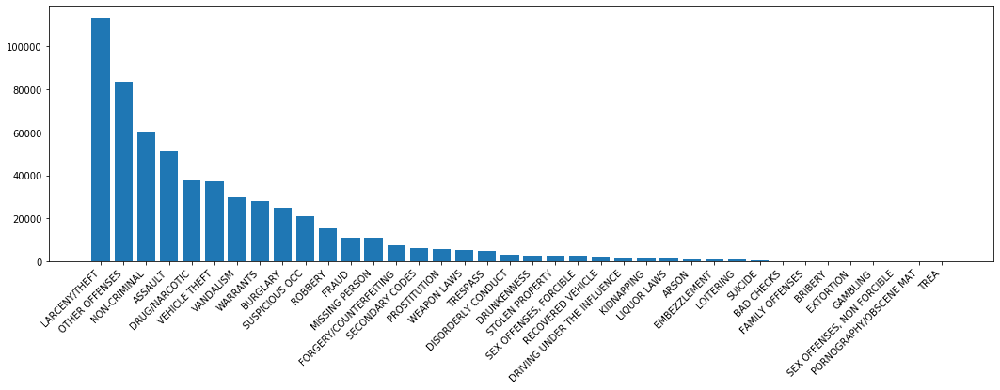

In [13]:
f, ax = plt.subplots(figsize=(18,5))
plt.bar(list(crime_data_n_by_category.keys()), list(crime_data_n_by_category.values()))
plt.xticks(rotation=45, ha='right')
plt.show()

## Part 1: Temporal Patterns: Crimes over time

In [14]:
import math

def time_plot(time_data_set, subset_crimes, rotation = False, bar = True):
    # Initialize the figure
    f, ax = plt.subplots(figsize=(30,19))

    # create a color palette
    palette = plt.get_cmap('Set1')

    # multiple line plot
    idx=0
    subset_size = len(subset_crimes)
    
    for k1, v1 in time_data_set.items():
        if k1 in subset_crimes:
            idx+=1

            # Find the right spot on the plot
            plt.subplot(math.ceil(subset_size/2),2,idx)

            # Plot the lineplot
            if bar:
                plt.bar(list([k for k, v in v1.items()]), list([v for k, v in v1.items()]), linewidth=1.9, alpha=0.9, label=k1)
            else:
                plt.plot(list([k for k, v in v1.items()]), list([v for k, v in v1.items()]), linewidth=1.9, alpha=0.9, label=k1)

            plt.tick_params(labelsize=13)

            # Not ticks everywhere
            if idx < subset_size - 1:
                plt.tick_params(axis='x',          # changes apply to the x-axis
                                which='both',      # both major and minor ticks are affected
                                bottom=False,      # ticks along the bottom edge are off
                                top=False,         # ticks along the top edge are off
                                labelbottom=False) # labels along the bottom edge are off
            

            # Add title
            plt.title(k1, loc='left', fontsize=20, fontweight=0)
            
            if rotation: plt.xticks(rotation=55)

### Data pre-processing  for time points

In [163]:
from collections import defaultdict

crime_data_n_by_year = defaultdict(lambda: 0)

crime_data_n_by_year_category = defaultdict(lambda: defaultdict(lambda: 0))
crime_data_n_by_month_category = defaultdict(lambda: defaultdict(lambda: 0))
crime_data_n_by_week_category = defaultdict(lambda: defaultdict(lambda: 0))
crime_data_n_by_daycycle_category = defaultdict(lambda: defaultdict(lambda: 0))
crime_data_n_by_hourweek_category = defaultdict(lambda: defaultdict(lambda: defaultdict(lambda: 0)))


In [174]:
import copy 

month_n_to_pref = {1: "Jan", 2: "Feb", 3: "Mar", 4: "Apr", 5: "May", 6: "Jun",\
    7: "Jul", 8: "Aug", 9: "Sep", 10: "Oct", 11: "Nov", 12: "Dec"}
week_order = {"Monday": 0, "Tuesday": 0, "Wednesday":0, "Thursday":0, "Friday":0, "Saturday":0, "Sunday":0}

def time_to_daycycle(crime):
    time1 = int(crime["Time"].split(':')[0])
    time2 = time1 + 1
    if time1<10:
        time1 = '0'+str(time1)
    if time2<10:
        time2 = '0'+str(time2)
    return f'{str(time1)}hto{str(time2)}h'

crime_data_n_by_week_category[category]

for idx, crime in crime_data.iterrows():
    
    year = crime["Date"].split('/')[2]
    month = crime["Date"].split('/')[0]

    daycycle = time_to_daycycle(crime)
    category = crime["Category"]

    crime_data_n_by_year[int(year)] += 1
    
    crime_data_n_by_year_category[category][int(year)] += 1
    
    if len(crime_data_n_by_week_category[category]) == 0:
        crime_data_n_by_month_category[category] = {m:0 for m in list(month_n_to_pref.values())}
    crime_data_n_by_month_category[category][month_n_to_pref[int(month)]] += 1

    if len(crime_data_n_by_week_category[category]) == 0:
        crime_data_n_by_week_category[category] = {m:0 for m in list(week_order.keys())}
    crime_data_n_by_week_category[category][crime["DayOfWeek"]] += 1
    
    if len(crime_data_n_by_week_category[category]) == 0:
        crime_data_n_by_hourweek_category[category] = {m:defaultdict(lambda: 0) for m in list(week_order.keys())}
    crime_data_n_by_hourweek_category[category][crime["DayOfWeek"]][daycycle] += 1

    crime_data_n_by_daycycle_category[category][daycycle] += 1


In [182]:
crime_data_n_by_daycycle_category1 = {k: {k1 : v[k1] for k1 in sorted(v)} for k, v in crime_data_n_by_daycycle_category.items()}

In [180]:
crime_data_n_by_hourweek_category1 = {k1 : {f'{k2}_{k3}': v1[k2][k3] for k2 in week_order for k3 in sorted(v1[k2])} for k1, v1 in crime_data_n_by_hourweek_category.items()}

### 1.1. Weekly patterns

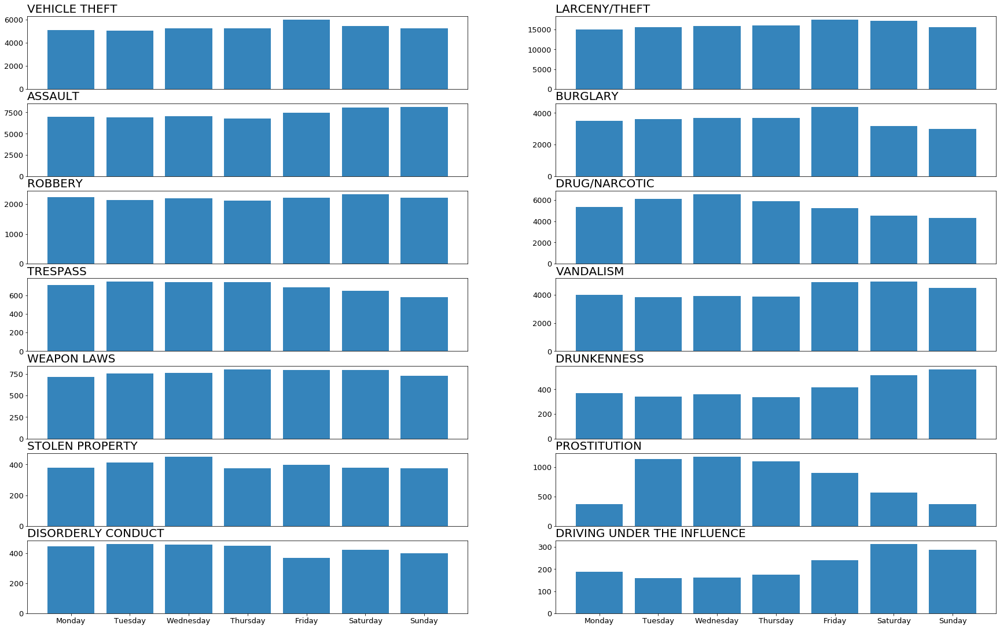

In [132]:
time_plot(crime_data_n_by_week_category, focuscrimes)

### 1.2. Monthly patterns

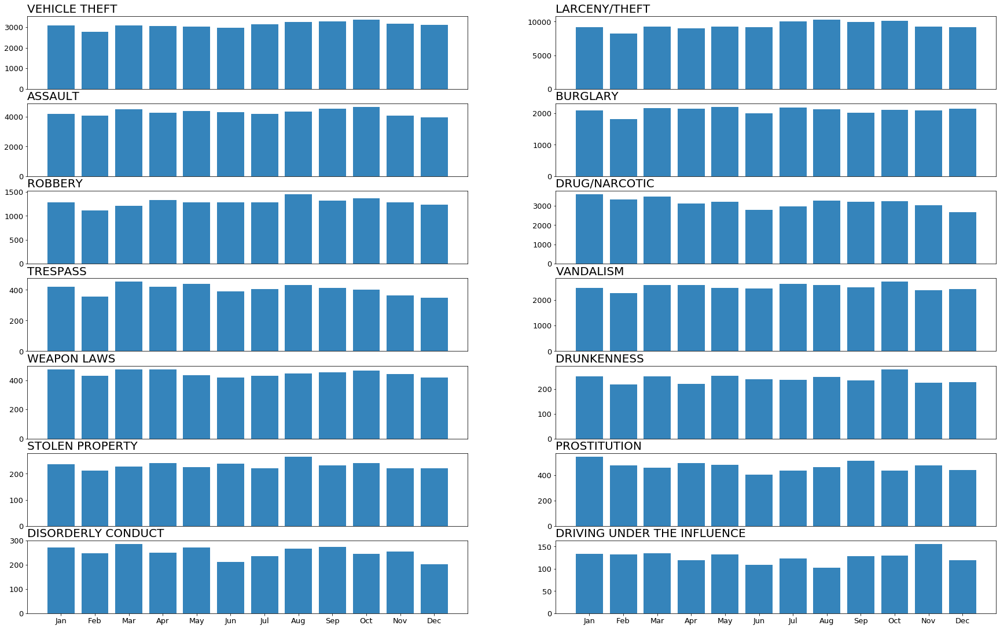

In [133]:
time_plot(crime_data_n_by_month_category, focuscrimes)

### 1.3. Daily cycle patterns

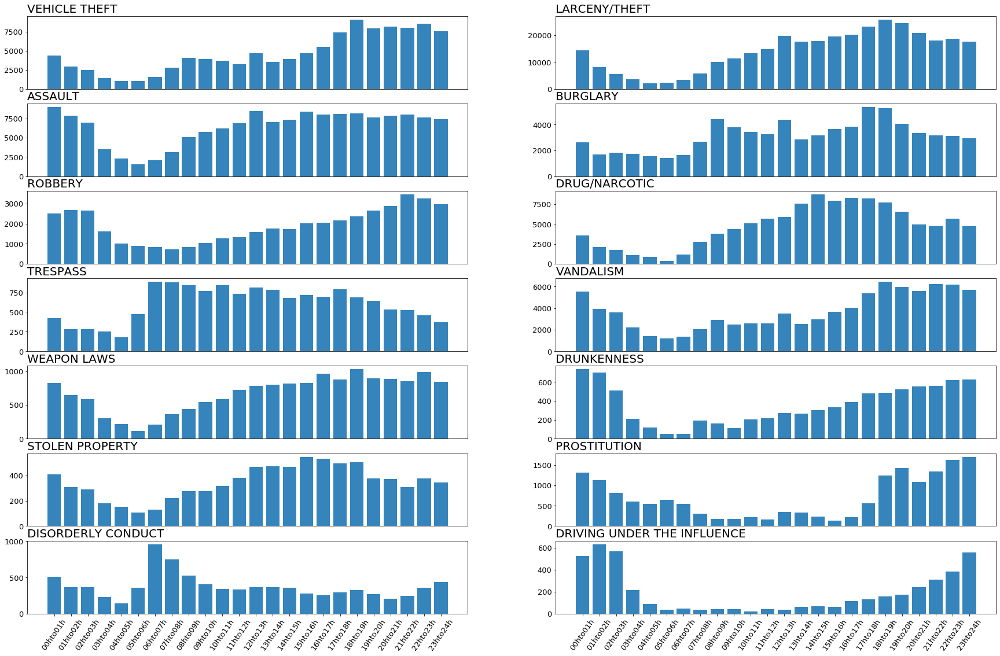

In [184]:
time_plot(crime_data_n_by_daycycle_category1, focuscrimes, True)

### 1.4. Weekly hours patterns

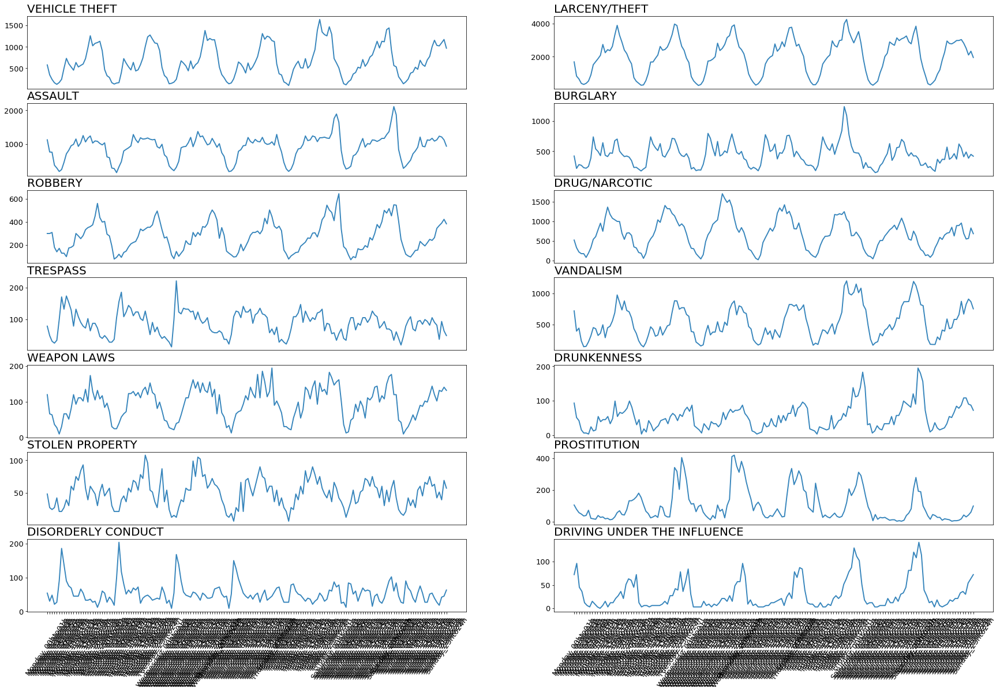

In [185]:
time_plot(crime_data_n_by_hourweek_category1, focuscrimes, True, False)

### First discussion

First mention that probably due to missing data or some inputing issue, the crime decreases drasticaly from 2013 on, so it will be only interpreted until 2013.

It is interpreted from the broken down plots by kind-category of assault, the *following trends*:

* Overall, the criminality slightly decreased from early 2000s until 2010, when it reached its lowest incidence. Nevertheless it raised again from then achieving its maximum at 2014.
* The vehicle theft droped considerably in 2005, which can be attributed to the [introduction of the new technology 'engine immobilizer systems'](https://www.nytimes.com/2014/08/12/upshot/heres-why-stealing-cars-went-out-of-fashion.html)
* Assaults were the most stable-mantained tendency, together with weapon-laws, showing little fluctuation douring the years.
* Apart from the vehivle theft lowering, prostitution also decreased linealy over the years.
* Disorderly conduct had some irregular tencende, decreassing, rising again and then decreasing again.
* Driving under the influence of alcohol reached its lower point at 2005 and then incrementing reaching its peek at 2009, and then after lowering the tendency until 2015.
* Stolen propery is showing an outstanding increment over the last years of data.

In summary, it can be discerned some common trends between categories over time, which can be related certain to social circumstances or the introduction of some inovation/change/regulation as previous mentioned with the 'engine immobilizer systems'. For example, the economical wellness during mid-2000s in South-Europe and USA (construction bubble) can be associated with the low-criminality during that period; then after the economical crisis that cracked in 2008 can explain the new raise in criminal activity. 
With all, mention that the expectations taking into account my point of view, expected the data to show a reduction in criminality over the years together with a linear social progress. Notwithstanding the data shows a different trend, reflecting that social behaviours are irregular (with ups and downs rather than a constant tendency).

## Part 2: Thinking about data and visualization

### 2.1. *Pearson correlation* [1]

**Pearson correlation** coefficient is an index that measures the linear relationship between two quantitative-continuous variables. Unlike **covariance**, Pearson correlation is independent of the scale of measurement of the variables, meaning that variables scaled in diferent range can be extracted the correlation.

### 2.2. Difference between a *bar-chart* and a *histogram* [2]

**Bar-charts** are meant to compare variables thus including categorical information, meanwhile **histograms** plot frequencies on a distribution based on *bins* or *intervalaas*. Eventhough they may look visually symilar, they still hold a distintion in their graphical representaation: **Bar-charts** add gaps between bars, meanwhil **histogram** bars are joined without any gap.

### 2.3. Bin-size in histograms criteria  [3]

* Bins should be all the same size. For example, groups of ten or a hundred.
* Choose between 5 and 20 bins. The larger the data set, the more likely you’ll want a large number of bins.
* Boundaries for bins should land at whole numbers whenever possible (this makes the chart easier to read).

## Part 3: Generating important plot types

### 3.1. $Jitter-plot$  with  `seaborn` 

In [22]:
crime_for_data_period = {crime_category : v['13hto14h'] for crime_category, v in crime_data_n_by_daycycle_category.items()}
df_crime_for_data_period = pd.DataFrame.from_dict({'': ['crime']*len(crime_for_data_period), 'crime_13hto14h': list(crime_for_data_period.values())})
df_crime_for_data_period.head()

,,crime_13hto14h
0,crime,1187
1,crime,5873
2,crime,4226
3,crime,612
4,crime,126


Let time run on the $x$-axis and create vertical jitter.

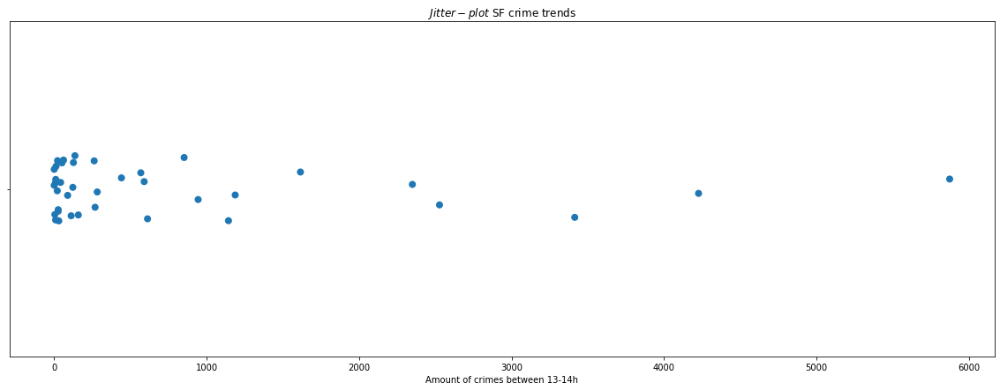

In [23]:
import seaborn as sns

g = sns.stripplot(x = df_crime_for_data_period['crime_13hto14h'], size=8,
                  jitter = True).set(title='$Jitter-plot$ SF crime trends', xlabel='Amount of crimes between 13-14h')

fig = plt.gcf()
fig.set_size_inches(20, 7)

### 3.2. GPS Data Histogram

In [24]:
crime_data_categories_filter = crime_data['Category'].isin(['FRAUD', 'VEHICLE THEFT'])
crime_data_time_filter = crime_data['Time'].between('22:00', '23:00')


len(crime_data[crime_data_time_filter & crime_data_categories_filter])

4765

In [25]:
coordenates_pd = pd.concat([crime_data[crime_data_time_filter & crime_data_categories_filter]['X'], crime_data[crime_data_time_filter & crime_data_categories_filter]['Y']], axis=1)
coordenates_pd.head()

,X,Y
54,-122.430082,37.767663
259,-122.415947,37.800546
335,-122.416407,37.753151
342,-122.468572,37.773335
542,-122.414959,37.728659


In [26]:
coordenates_pd = [x.astype(float)[1] for x in coordenates_pd.to_numpy()]

In [27]:
bined_latitudes = np.histogram(coordenates_pd, bins=50)
bined_latitudes

(array([ 57,  94,  79,  80,  84, 103,  72,  64,  73, 102, 124,  81, 105,
         89,  78,  78,  68,  83,  82,  84, 117, 140,  91, 136, 158, 176,
        146, 100,  87, 121, 137, 182, 157, 144, 171, 152, 171, 141,  86,
         77,  57,  72,  94,  46,  56,  50,  11,   8,   0,   1]),
 array([37.70825846, 37.7103871 , 37.71251574, 37.71464439, 37.71677303,
        37.71890168, 37.72103032, 37.72315896, 37.72528761, 37.72741625,
        37.7295449 , 37.73167354, 37.73380218, 37.73593083, 37.73805947,
        37.74018811, 37.74231676, 37.7444454 , 37.74657405, 37.74870269,
        37.75083133, 37.75295998, 37.75508862, 37.75721727, 37.75934591,
        37.76147455, 37.7636032 , 37.76573184, 37.76786049, 37.76998913,
        37.77211777, 37.77424642, 37.77637506, 37.77850371, 37.78063235,
        37.78276099, 37.78488964, 37.78701828, 37.78914693, 37.79127557,
        37.79340421, 37.79553286, 37.7976615 , 37.79979015, 37.80191879,
        37.80404743, 37.80617608, 37.80830472, 37.81043337,

Text(0.5, 0, 'Latitude (Y)')

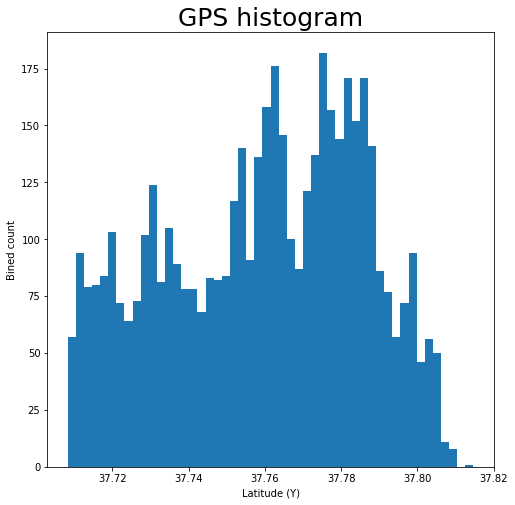

In [28]:
plt.figure(figsize=(8,8))
plt.hist(coordenates_pd, 50)
plt.title('GPS histogram', fontsize=25)
plt.ylabel('Bined count')
plt.xlabel('Latitude (Y)')


## Part 4: A bit of geo-data

In [29]:
import folium

### 4.1. San Francisco map

In [30]:
SF_lat = 37.773972
SF_lon = -122.431297
SF_map = folium.Map([SF_lat, SF_lon], zoom_start=13, tiles="Stamen Toner")
SF_map

### 4.2. San Francisco City-Hall Marker

In [31]:
import json
import requests

SF_map = folium.Map([SF_lat, SF_lon], zoom_start=13, tiles="Stamen Toner")

url = (
    "https://raw.githubusercontent.com/python-visualization/folium/master/examples/data"
)
vis1 = json.loads(requests.get(f"{url}/vis1.json").text)

folium.Marker(
    location=[37.77919, -122.41914],
    popup=folium.Popup(max_width=450).add_child(
        folium.Vega(vis1, width=450, height=250)
    ),
).add_to(SF_map)
SF_map

### 4.3. San Francisco City-Hall Marker

In [32]:
crime_data_categories_filter = crime_data['Category'].isin(['PROSTITUTION'])
crime_data_time_filter = crime_data['Date'].between('06/01/2016	', '06/31/2016	')

coordenates_pd = pd.concat([crime_data[crime_data_time_filter & crime_data_categories_filter]['X'], crime_data[crime_data_time_filter & crime_data_categories_filter]['Y']], axis=1)
print(len(coordenates_pd))
coordenates_pd.head()

390


,X,Y
741,-122.415930,37.760433
3871,-122.419226,37.791705
6217,-122.421721,37.791445
6695,-122.417964,37.758697
8830,-122.416390,37.765249


In [33]:
for x in coordenates_pd.to_numpy():
    folium.Marker(
    location=[x[1], x[0]],
    popup=folium.Popup(max_width=450).add_child(
        folium.Vega(vis1, width=450, height=250)
    ),).add_to(SF_map)
    
SF_map
    

## Part 5: Errors in the data. The importance of looking at raw

Such errors, identified as outliers, can influence in:
* **Bias the binned versions**: Since they may create vary the range of other bins or even generate new(s) bin which truly not represent the underlying version data.
* **Misconceptions data**: They can lead to wrong interpretations of the data analysis, assuming peaks for example, or varying some data models fittings.

## References

**[1]** Pearson’s Correlation Coefficient [https://www.statisticssolutions.com/pearsons-correlation-coefficient/]

**[2]** A Histogram is NOT a Bar Chart [https://www.forbes.com/sites/naomirobbins/2012/01/04/a-histogram-is-not-a-bar-chart/]

**[3]** What is a bin in statistics: Choosing bins [https://www.statisticshowto.com/choose-bin-sizes-statistics/]